<a href="https://colab.research.google.com/github/arielfikru/ml_stuff/blob/main/Face_detection_crop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git lfs install
!git clone https://huggingface.co/datasets/nekofura/avatara_project
!wget -r https://huggingface.co/nekofura/yolo/resolve/main/yolov5s_anime.pt yolov5s_anime.pt

Git LFS initialized.
Cloning into 'avatara_project'...
remote: Enumerating objects: 16, done.
remote: Counting objects: 100% (13/13), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 16 (delta 3), reused 0 (delta 0), pack-reused 3
Unpacking objects: 100% (16/16), 2.06 KiB | 702.00 KiB/s, done.
--2023-11-12 03:59:12--  https://huggingface.co/nekofura/yolo/resolve/main/yolov5s_anime.pt
Resolving huggingface.co (huggingface.co)... 18.172.134.24, 18.172.134.88, 18.172.134.124, ...
Connecting to huggingface.co (huggingface.co)|18.172.134.24|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs-us-1.huggingface.co/repos/38/b3/38b3f0f52e7dbcbafaafae67ebff4cc744e63cff0bd6f06802c1049b8d69c1af/237e6fa848b1a2e276465c17cca933f27f498ed701ab12e7c06d1ef8959c62bf?response-content-disposition=attachment%3B+filename*%3DUTF-8%27%27yolov5s_anime.pt%3B+filename%3D%22yolov5s_anime.pt%22%3B&Expires=1700020752&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlv

In [ ]:
#Unzip
import shutil
import os

# Ganti dengan path file ZIP Anda dan path ekstraksi yang diinginkan
zip_file_path = '/content/avatara_project/yor_forger.zip'
extracted_folder_path = '/content/avatara_project/yor_forger'

# Membuat folder untuk mengekstrak file
os.makedirs(extracted_folder_path, exist_ok=True)

# Mengekstrak file ZIP
shutil.unpack_archive(zip_file_path, extracted_folder_path)


In [ ]:
import torch
from pathlib import Path
import os
import cv2

custom_weights = '/content/huggingface.co/nekofura/yolo/resolve/main/yolov5s_anime.pt'
input_folder = '/content/avatara_project/yor_forger/yor_briar 1girl solo sweater'
output_folder = '/content/drive/MyDrive/neko/'
expand_box = 1.25
render_box = False
print_log = True

os.makedirs(output_folder, exist_ok=True)

model = torch.hub.load('ultralytics/yolov5', 'custom', path=custom_weights, force_reload=True)

def adjust_bbox(bbox, expand_factor, img_width, img_height):
    x1, y1, x2, y2 = bbox
    width = x2 - x1
    height = y2 - y1
    new_width = width * expand_factor
    new_height = height * expand_factor
    new_x1 = max(x1 - (new_width - width) / 2, 0)
    new_y1 = max(y1 - (new_height - height) / 2, 0)
    new_x2 = min(x2 + (new_width - width) / 2, img_width)
    new_y2 = min(y2 + (new_height - height) / 2, img_height)
    return new_x1, new_y1, new_x2, new_y2

for img_path in Path(input_folder).glob('*.*'):
    original_img = cv2.imread(str(img_path))

    results = model(original_img)

    if not render_box:
        img_height, img_width, _ = original_img.shape
    else:
        rendered_img = results.render()[0]
        img_height, img_width, _ = rendered_img.shape

    for idx, det in enumerate(results.xyxy[0]):
        bbox = adjust_bbox(det[:4].cpu().numpy(), expand_box, img_width, img_height)

        x1_new, y1_new, x2_new, y2_new = map(int, bbox)

        save_path = os.path.join(output_folder, f"{img_path.stem}_{idx}.jpg")

        if not render_box:
            cropped_img = original_img[y1_new:y2_new, x1_new:x2_new]
            cv2.imwrite(save_path, cropped_img)
        else:
            cropped_img = rendered_img[y1_new:y2_new, x1_new:x2_new]
            cv2.imwrite(save_path, cropped_img)

    if print_log:
        print(f'Processed {img_path}')


/usr/local/lib/python3.10/dist-packages/torch/hub.py:294: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
requirements: Ultralytics requirements ['gitpython>=3.1.30', 'Pillow>=10.0.1'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.

Processed /content/avatara_project/yor_forger/yor_briar 1girl solo sweater/safebooru_4570656_5a0aa967f78bc5819b820f146f5ef701.jpg
Processed /content/avatara_project/yor_forger/yor_briar 1girl solo sweater/safebooru_4016388_ce85e55458491277039e85789fe4cb42.png
Processed /content/avatara_project/yor_forger/yor_briar 1girl solo sweater/safebooru_3973033_727d01591365604295df73ebbf055762.png
Processed /content/avatara_project/yor_forger/yor_briar 1girl solo sweater/safebooru_4176379_0501752aac138ba90c0ba216ab1e030f.jpg
Processed /content/avatara_project/yor_forger/yor_briar 1girl solo sweater/safebooru_4398251_e2782c38ae506d6991763427daa6ffc7.png
Processed /content/avatara_project/yor_forger/yor_briar 1girl solo sweater/safebooru_4010919_755d16827bc90a1607d9b79a9d9db211.jpg
Processed /content/avatara_project/yor_forger/yor_briar 1girl solo sweater/safebooru_3983046_aead568d8e7aefc028c16d3fad9efd44.jpg
Processed /content/avatara_project/yor_forger/yor_briar 1girl solo sweater/safebooru_40025

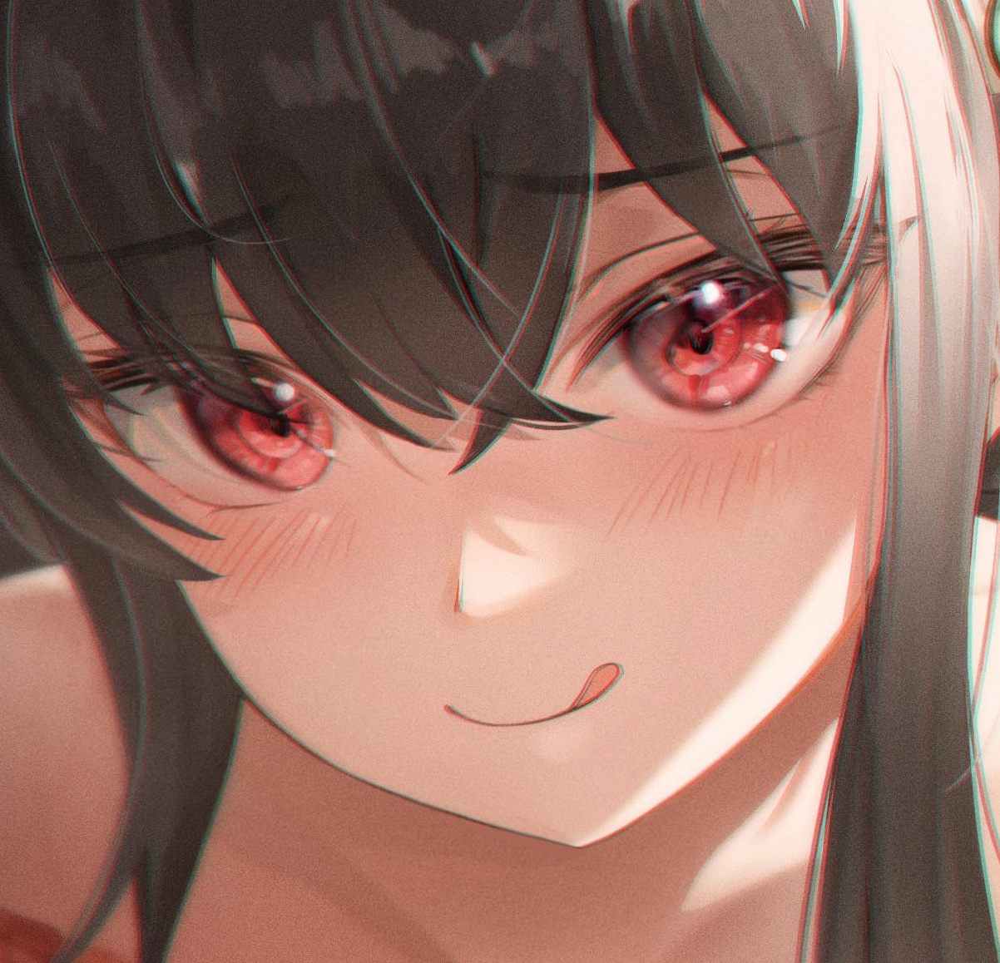

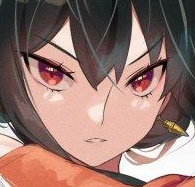

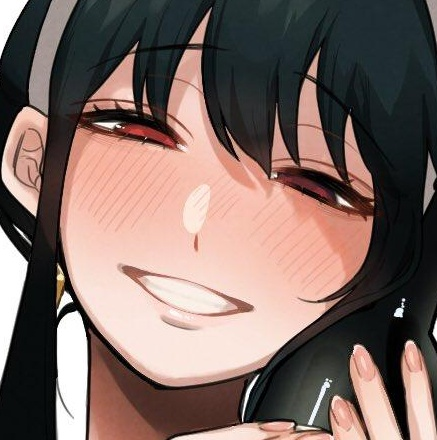

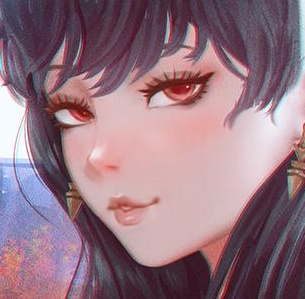

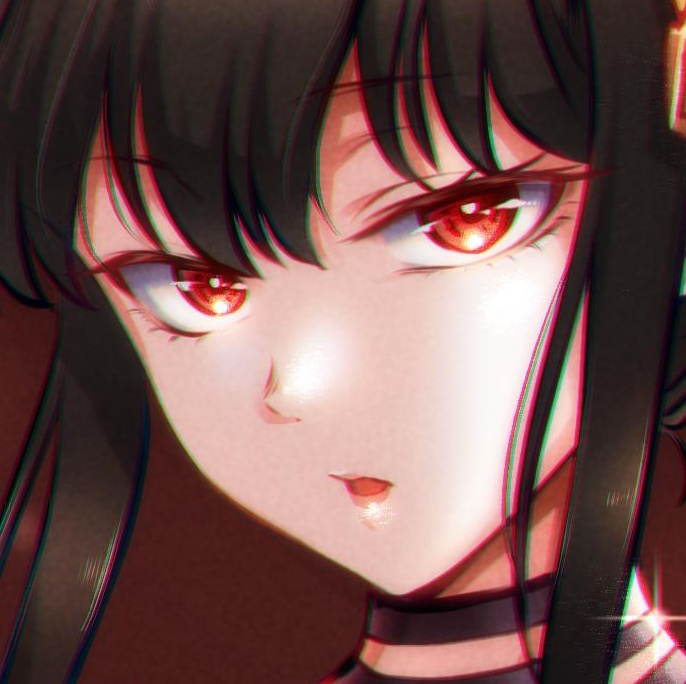

...

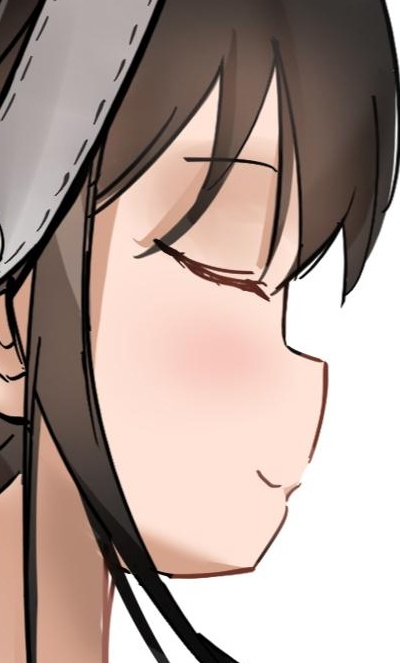

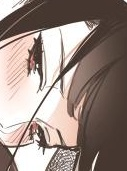

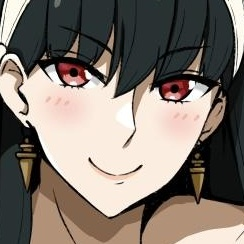

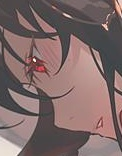

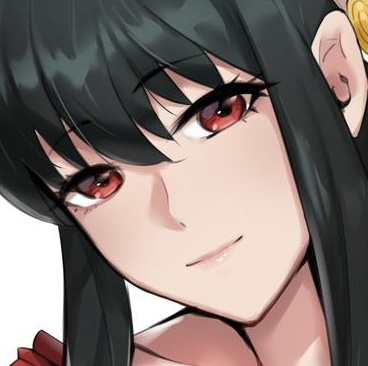

In [ ]:
import os
from IPython.display import display, HTML, Image

# Tentukan path folder yang berisi gambar-gambar
folder_path = '/content/drive/MyDrive/neko/'  # Ganti dengan path yang sesuai

# Ambil daftar nama file dalam folder
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Buat HTML untuk menampilkan gambar-gambar
html_output = '<div style="display: flex; flex-wrap: wrap; float: left; justify-content: flex-start;">'
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)

    try:
        display(Image(filename=image_path, width=200, height=200))
    except Exception as e:
        print(f"Unable to process {image_file}: {e}")

html_output += '</div>'

# Tampilkan HTML
display(HTML(html_output))
